<a href="https://colab.research.google.com/github/AdvaitSankhe/NeRF-Blender-Edits/blob/main/Pytorch_nerf_for_drums.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install --upgrade PyMCubes
!pip install pymesh
!pip install trimesh
!pip install pyvista
!pip install pyntcloud

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.3/274.3 kB 5.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pymesh: filename=pymesh-1.0.2-py3-none-any.whl size=6900 sha256=66b8fdb99126b03232b5556ef3ca4239fa58feea64a03fe89142eac5170f5315
  Stored in directory: /root/.cache/pip/wheels/3d/aa/05/b758da80b5028b4bbf0d0ed86ec9099ca40e195563fd32b7b8
Successfully built pymesh
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 688.5/688.5 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.0/92.0 MB 19.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 346.3/346.3 kB 5.6 MB/s eta 0:00:00


In [ ]:
!unzip -qq /content/drive/MyDrive/Python-Projects/drum.zip

In [ ]:
import cv2
import torch
import numpy as np
from tqdm import tqdm
import torch.nn as nn
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
import pandas as pd
from sklearn.cluster import DBSCAN
import pandas as pd
from trimesh import Trimesh
import pymesh
import re
import mcubes
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from PIL import Image
import tensorflow as tf
import json
import plotly.express as px
import torch
import torch.optim as optim
from pyntcloud import PyntCloud

/usr/local/lib/python3.10/dist-packages/pyntcloud/utils/numba.py:5: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def groupby_count(xyz, indices, out):
/usr/local/lib/python3.10/dist-packages/pyntcloud/utils/numba.py:12: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def groupby_sum(xyz, indices, N, out):
/usr/local/lib/python3.10/dist-packages/pyntcloud/utils/nu

In [ ]:
# Define lists to store vertex positions, normals, and faces
vertices = []
normals = []
faces = []

# Open and read the .obj file
with open("/content/drums_256.obj", "r") as obj_file:
    for line in obj_file:
        if line.startswith("v "):  # Vertex data
            vertex = [float(x) for x in re.findall(r"[-+]?\d*\.\d+|[-+]?\d+", line)]
            vertices.append(vertex)
        elif line.startswith("vn "):  # Normal data
            normal = [float(x) for x in re.findall(r"[-+]?\d*\.\d+|[-+]?\d+", line)]
            normals.append(normal)
        elif line.startswith("f "):  # Face data
            face = re.findall(r"\d+", line)  # Extract vertex indices
            face = [int(idx) for idx in face]
            faces.append(face)

# Convert lists to NumPy arrays
vertices = np.array(vertices)
normals = np.array(normals)
faces = np.array(faces)

In [ ]:
vertices.shape

(220648, 3)

In [ ]:
faces.shape

(442504, 3)

In [ ]:
# creating a list of column names
columnValues = ['x', 'y', 'z']

# creating the dataframe
df = pd.DataFrame(data = vertices,
                  columns = columnValues)

In [ ]:
fig = px.scatter_3d(df, x='x', y='y', z='z')
fig.show()

In [ ]:
df2 = {}
x = []
y = []
z = []

In [ ]:
for i in range(len(df)):
    x.append(int(df.iloc[i][0]))
    y.append(int(df.iloc[i][1]))
    z.append(int(df.iloc[i][2]))

df2['x'] = x
df2['y'] = y
df2['z'] = z

In [ ]:
revampDf = pd.DataFrame(df2)

In [ ]:
revampDfNew = revampDf.drop_duplicates()

In [ ]:
fig = px.scatter_3d(revampDfNew, x='x', y='y', z='z')
fig.show()

In [ ]:
# 3D numpy array
boxCage = np.zeros((250, 250, 250))

In [ ]:
for i in range(len(revampDfNew)):
    boxCage[revampDfNew.iloc[i][0]][revampDfNew.iloc[i][1]][revampDfNew.iloc[i][2]] = 1

## Steven Gerrard

In [ ]:
imgCheck =  boxCage.sum(axis=2)
imgCheck.shape

(250, 250)

In [ ]:
# Set all positive values to 1
imgCheck[imgCheck > 0] = 1
imgCheck[imgCheck <= 0] = 0

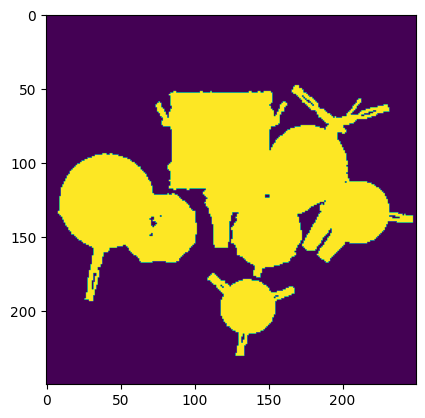

In [ ]:
plt.imshow(imgCheck)

In [ ]:
imgCheck =  boxCage.sum(axis=0)
imgCheck.shape

(250, 250)

In [ ]:
# Set all positive values to 1
imgCheck[imgCheck > 0] = 1
imgCheck[imgCheck <= 0] = 0

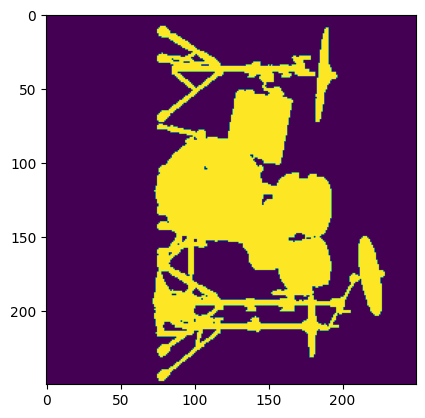

In [ ]:
plt.imshow(imgCheck)

## Preparing Ground Truths

In [ ]:
def make_ground_truth(orientation="left"):
    # left map
    if orientation == "left":
        # Read the PNG image
        image_path = '/content/drive/MyDrive/Python-Projects/done/left.png'
        img = Image.open(image_path)
        gray_img = img.convert('L')
        gray_img = gray_img.resize((250, 250), Image.ANTIALIAS)

        # Convert the image to a NumPy array for display in Matplotlib
        gray_img = np.array(gray_img)/255.0
        grey = np.where(gray_img > 0, 1, gray_img)

        # Rotate the image
        grey = np.rot90(grey, k=1, axes=(1, 0))

        # return ground truht
        return np.float32(grey)

    # right map
    if orientation == "right":
        # Read the PNG image
        image_path = '/content/drive/MyDrive/Python-Projects/done3/baseRight.png'
        img = Image.open(image_path)
        gray_img = img.convert('L')
        gray_img = gray_img.resize((250, 250), Image.ANTIALIAS)

        # Convert the image to a NumPy array for display in Matplotlib
        gray_img = np.array(gray_img)/255.0
        grey = np.where(gray_img > 0, 1, gray_img)

        # Rotate the image
        grey = np.rot90(grey, k=1, axes=(1, 0))
        grey = np.flipud(grey)

        # return ground truht
        return np.float32(grey)

    # top map
    if orientation == "top":
        # Read the PNG image
        image_path = '/content/drive/MyDrive/Python-Projects/done/top.png'
        img = Image.open(image_path)
        #img = img.transpose(Image.ROTATE_270)
        gray_img = img.convert('L')
        gray_img = gray_img.resize((250, 250), Image.ANTIALIAS)



        # Convert the image to a NumPy array for display in Matplotlib
        gray_img = np.array(gray_img)/255.0

        grey = np.where(gray_img > 0, 1, gray_img)

        # Rotate the image
        grey = np.rot90(grey, k=1, axes=(1, 0))

        # return ground truht
        return np.float32(grey)

    # centre map
    if orientation == "centre":
        # Read the PNG image
        image_path = '/content/drive/MyDrive/Python-Projects/done3/baseCentre.png'
        img = Image.open(image_path)
        gray_img = img.convert('L')
        gray_img = gray_img.resize((250, 250), Image.ANTIALIAS)

        # Convert the image to a NumPy array for display in Matplotlib
        gray_img = np.array(gray_img)/255.0
        grey = np.where(gray_img > 0, 1, gray_img)

        # Rotate the image
        grey = np.rot90(grey, k=1, axes=(1, 0))

        # return ground truht
        return np.float32(grey)

<ipython-input-21-7e469ab555f1>:26: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  gray_img = gray_img.resize((250, 250), Image.ANTIALIAS)


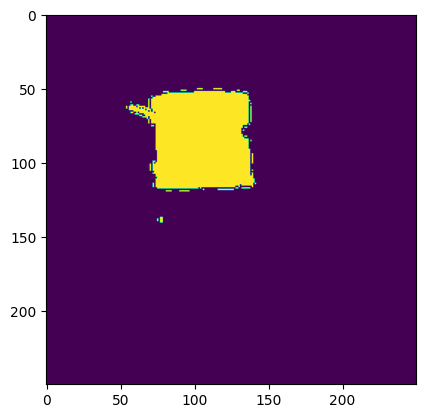

In [ ]:
plt.imshow(make_ground_truth(orientation="right"))

<ipython-input-21-7e469ab555f1>:67: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  gray_img = gray_img.resize((250, 250), Image.ANTIALIAS)


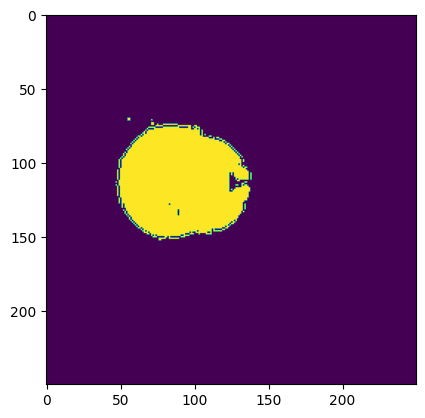

In [ ]:
plt.imshow(make_ground_truth(orientation="centre"))

In [ ]:
boxCage.shape

(250, 250, 250)

In [ ]:
# Identify points corresponding to the object in the segmentation map
object_mask = make_ground_truth(orientation="right") == 1  # Assuming object pixels are labeled as 1

# Use the mask to extract vertices from the original point cloud
object_point_cloud = boxCage.copy()  # Create a copy of the original tensor
object_point_cloud[~object_mask] = 0  # Set non-object vertices to 0

# The object_point_cloud will contain only the vertices belonging to the segmented object

# If needed, reshape the object_point_cloud to match the desired format
object_point_cloud = np.transpose(np.nonzero(object_point_cloud))

<ipython-input-21-7e469ab555f1>:26: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  gray_img = gray_img.resize((250, 250), Image.ANTIALIAS)


In [ ]:
object_mask.shape

(250, 250)

In [ ]:
fig = px.scatter_3d(object_point_cloud, x=0, y=1, z=2)
fig.show()

In [ ]:
# Identify points corresponding to the object in the segmentation map
object_mask = make_ground_truth(orientation="centre") == 1  # Assuming object pixels are labeled as 1

# Use the mask to extract vertices from the original point cloud
object_point_cloud1 = boxCage.copy()  # Create a copy of the original tensor
object_point_cloud1[~object_mask] = 0  # Set non-object vertices to 0

# The object_point_cloud will contain only the vertices belonging to the segmented object

# If needed, reshape the object_point_cloud to match the desired format
object_point_cloud1 = np.transpose(np.nonzero(object_point_cloud1))

<ipython-input-31-7e469ab555f1>:67: DeprecationWarning:

ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.



In [ ]:
fig = px.scatter_3d(object_point_cloud1, x=0, y=1, z=2)
fig.show()

In [ ]:
object_point_cloud1.shape, object_point_cloud.shape

((50556, 3), (66959, 3))

In [ ]:
concatenated_array = np.concatenate((object_point_cloud1, object_point_cloud), axis=0)

In [ ]:
# Convert the NumPy array to a pandas DataFrame
new = pd.DataFrame(object_point_cloud, columns=['x', 'y', 'z'])
fig = px.scatter_3d(new, x='x', y='y', z='z')
fig.show()

In [ ]:
# Convert DataFrame to a NumPy array
point_cloud = new.values

# Initialize DBSCAN with appropriate epsilon and min_samples values
epsilon = 1  # Adjust this based on the scale of your data
min_samples = 6  # Adjust according to the density of your data
dbscan = DBSCAN(eps=epsilon, min_samples=min_samples)

# Fit DBSCAN to the point cloud data
dbscan.fit(point_cloud)

# Get labels and identify outliers (points labeled as -1 by DBSCAN)
outliers_mask = dbscan.labels_ == -1

# Filter out the outliers from the original DataFrame
filtered_df = new[~outliers_mask]

In [ ]:
# Convert the NumPy array to a pandas DataFrame
fig = px.scatter_3d(filtered_df, x='x', y='y', z='z')
fig.show()

In [ ]:
filtered_df.head()

,x,y,z
0,52,104,80
1,52,105,80
2,52,111,144
3,53,84,109
4,53,84,110


## Applying the transformation maps

## Attempt 1 Bobby Firmino Conv

In [ ]:
# Define a function for patch-wise loss computation
def patch_wise_loss(y_pred, y_true, patch_size=(16, 16)):
    height, width = y_pred.shape[:2]
    patch_h, patch_w = patch_size

    total_loss = 0.0
    count = 0

    # Iterate through the patches
    for i in range(0, height - patch_h + 1, patch_h):
        for j in range(0, width - patch_w + 1, patch_w):
            # Extract patches from both predicted and ground truth maps
            pred_patch = y_pred[i:i + patch_h, j:j + patch_w]
            true_patch = y_true[i:i + patch_h, j:j + patch_w]

            # Compute loss for the current patch (e.g., mean squared error)
            patch_loss = np.mean(np.square(pred_patch - true_patch))
            total_loss += patch_loss
            count += 1

    # Calculate the mean patch-wise loss
    mean_patch_loss = total_loss / count if count > 0 else 0.0
    return mean_patch_loss

In [ ]:
# Example function for the forward pass (adding along the Y-axis to create an image)
def forward_pass(input_tensor):
    # Your forward pass logic to create an image (summing along the Y-axis, for example)
    image = np.sum(input_tensor, axis=1)
    return image

## Attempt 2 Franscesc Fabregas

In [ ]:
def patch_wise_loss_tensor(y_pred, y_true, patch_size=(16, 16)):
    height, width = y_pred.shape[:2]
    patch_h, patch_w = patch_size

    total_loss = 0.0
    count = 0

    for i in range(0, height - patch_h + 1, patch_h):
        for j in range(0, width - patch_w + 1, patch_w):
            pred_patch = y_pred[i:i + patch_h, j:j + patch_w]
            true_patch = y_true[i:i + patch_h, j:j + patch_w]

            patch_loss = torch.mean((pred_patch - true_patch) ** 2)
            total_loss += patch_loss
            count += 1

    mean_patch_loss = total_loss / count if count > 0 else 0.0
    return mean_patch_loss

In [ ]:
# Example function for the forward pass (adding along the Y-axis to create an image)
def forward_pass(input_tensor):
    image = input_tensor.sum(dim=1)
    image = torch.clamp(image, 0.0, 1.0)
    return image

In [ ]:
# Function to compute gradient with respect to input tensor
def compute_gradient(input_tensor, segmentation_map, learning_rate=0.01, epochs=100):
    optimizer = optim.Adam([input_tensor], lr=learning_rate)
    for epoch in range(epochs):
        optimizer.zero_grad()
        predicted_image = forward_pass(input_tensor)
        predicted_image = torch.clamp(predicted_image, 0.0, 1.0)
        predited_image = torch.where(predicted_image > 0, torch.tensor(1.0), torch.tensor(0.0))
        loss = patch_wise_loss_tensor(predicted_image, torch.tensor(segmentation_map, dtype=torch.float32) )

        #input_tensor = torch.where(input_tensor > 0, torch.tensor(1.0), torch.tensor(0.0))
        #input_tensor.requires_grad = True

        loss.backward()
        optimizer.step()


        print(f"Epoch {epoch + 1}/{epochs}, Loss: {loss.item()}")

In [ ]:
# convert to tensor
inpTensor = torch.tensor(boxCage, dtype=torch.float32, requires_grad=True)

In [ ]:
compute_gradient(inpTensor, make_ground_truth(orientation="right"), learning_rate=0.01, epochs=100)

<ipython-input-22-5130f1c36831>:26: DeprecationWarning:

ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.



Epoch 1/100, Loss: 0.22772569954395294
Epoch 2/100, Loss: 0.20685763657093048
Epoch 3/100, Loss: 0.20685763657093048
Epoch 4/100, Loss: 0.20685763657093048
Epoch 5/100, Loss: 0.20685763657093048
Epoch 6/100, Loss: 0.20685763657093048
Epoch 7/100, Loss: 0.20685763657093048
Epoch 8/100, Loss: 0.20685763657093048
Epoch 9/100, Loss: 0.20685763657093048
Epoch 10/100, Loss: 0.20685763657093048
Epoch 11/100, Loss: 0.20685763657093048
Epoch 12/100, Loss: 0.20685763657093048
Epoch 13/100, Loss: 0.20685763657093048
Epoch 14/100, Loss: 0.20685763657093048
Epoch 15/100, Loss: 0.20685763657093048
Epoch 16/100, Loss: 0.20685763657093048
Epoch 17/100, Loss: 0.20685763657093048
Epoch 18/100, Loss: 0.20685763657093048
Epoch 19/100, Loss: 0.20685763657093048
Epoch 20/100, Loss: 0.20685763657093048
Epoch 21/100, Loss: 0.20685763657093048
Epoch 22/100, Loss: 0.20685763657093048
Epoch 23/100, Loss: 0.20685763657093048
Epoch 24/100, Loss: 0.20685763657093048
Epoch 25/100, Loss: 0.20685763657093048
Epoch 26/

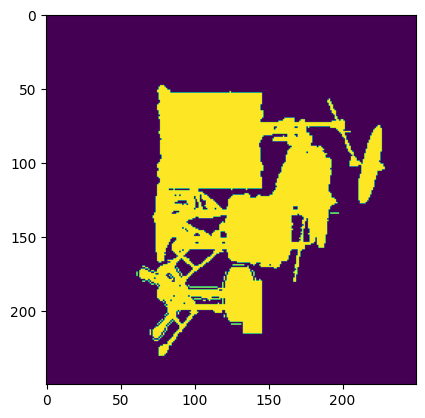

In [ ]:
plt.imshow(forward_pass(inpTensor).detach().numpy())

## Mohammed Salah - Please work

In [ ]:
# Function to isolate segmented object from the original tensor
def isolate_segmented_object(original_tensor, segmentation_map, threshold_value):
    # Thresholding to create a binary mask
    thresholded_mask = (segmentation_map > threshold_value)

    # Ensure the mask is a boolean tensor
    thresholded_mask = thresholded_mask.bool()

    # Initialize an empty tensor of the same shape as the original tensor
    isolated_tensor = torch.zeros_like(original_tensor)

    # Update the isolated tensor based on the binary mask
    isolated_tensor = torch.where(thresholded_mask.unsqueeze(0), original_tensor, isolated_tensor)

    return isolated_tensor


# Function to optimize isolated tensor to refine the segmented object
def optimize_segmented_object(isolated_tensor, segmentation_map, learning_rate=0.01, epochs=100):
    isolated_tensor = torch.nn.Parameter(isolated_tensor)  # Wrap tensor in a Parameter

    optimizer = torch.optim.Adam([isolated_tensor], lr=learning_rate)

    for epoch in range(epochs):
        optimizer.zero_grad()

        # Your forward pass and loss calculation here
        predicted_image = forward_pass(isolated_tensor)  # Replace this with your forward pass
        loss = patch_wise_loss_tensor(predicted_image, torch.tensor(segmentation_map, dtype=torch.float32))

        loss.backward()
        optimizer.step()

        print(f"Epoch {epoch + 1}/{epochs}, Loss: {loss.item()}")

In [ ]:
# Usage:
original_tensor = torch.tensor(boxCage.copy(), dtype=torch.float32, requires_grad=True)  # Your original tensor containing vertices
segmentation_map = torch.tensor(make_ground_truth(orientation="right"))  # Segmentation map of the object
threshold_value = 1   # Threshold value for binary mask creation

# Step 1: Isolate segmented object
isolated_object = isolate_segmented_object(original_tensor, segmentation_map, threshold_value)

# Step 2: Optimize the isolated object tensor
optimize_segmented_object(isolated_object, segmentation_map)

<ipython-input-31-7e469ab555f1>:26: DeprecationWarning:

ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.

<ipython-input-55-6d2e3df288e8>:29: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



Epoch 1/100, Loss: 0.07501736283302307
Epoch 2/100, Loss: 0.0
Epoch 3/100, Loss: 0.0
Epoch 4/100, Loss: 0.0
Epoch 5/100, Loss: 0.0
Epoch 6/100, Loss: 0.0
Epoch 7/100, Loss: 0.0
Epoch 8/100, Loss: 0.0
Epoch 9/100, Loss: 0.0
Epoch 10/100, Loss: 0.0
Epoch 11/100, Loss: 0.0
Epoch 12/100, Loss: 0.0
Epoch 13/100, Loss: 0.0
Epoch 14/100, Loss: 0.0
Epoch 15/100, Loss: 0.0
Epoch 16/100, Loss: 0.0
Epoch 17/100, Loss: 0.0
Epoch 18/100, Loss: 0.0
Epoch 19/100, Loss: 0.0
Epoch 20/100, Loss: 0.0
Epoch 21/100, Loss: 0.0
Epoch 22/100, Loss: 0.0
Epoch 23/100, Loss: 0.0
Epoch 24/100, Loss: 0.0
Epoch 25/100, Loss: 0.0
Epoch 26/100, Loss: 0.0
Epoch 27/100, Loss: 0.0
Epoch 28/100, Loss: 0.0
Epoch 29/100, Loss: 0.0
Epoch 30/100, Loss: 0.0
Epoch 31/100, Loss: 0.0
Epoch 32/100, Loss: 0.0
Epoch 33/100, Loss: 0.0
Epoch 34/100, Loss: 0.0
Epoch 35/100, Loss: 0.0
Epoch 36/100, Loss: 0.0
Epoch 37/100, Loss: 0.0
Epoch 38/100, Loss: 0.0
Epoch 39/100, Loss: 0.0
Epoch 40/100, Loss: 0.0
Epoch 41/100, Loss: 0.0
Epoch 42/

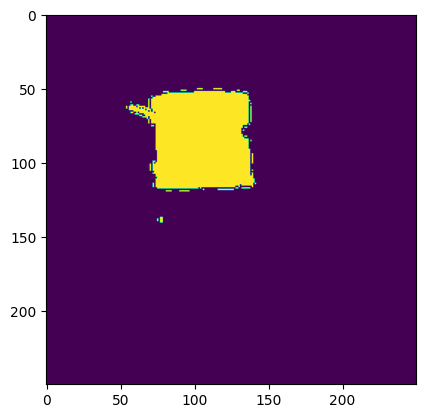

In [ ]:
plt.imshow(forward_pass(isolated_object).detach().numpy())

## Thierry Henry

In [ ]:
isolated_object = torch.where(isolated_object > 0, torch.tensor(1.0), torch.tensor(0.0))
res = isolated_object.detach().numpy()

In [ ]:
np.unique(res)

array([0., 1.], dtype=float32)

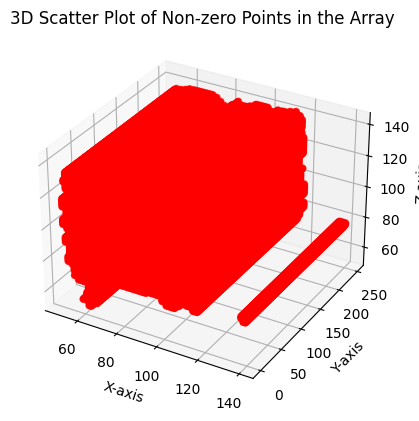

In [ ]:
indices = np.argwhere(res == 1)
x_indices, y_indices, z_indices = indices[:, 0], indices[:, 1], indices[:, 2]

# Create a 3D scatter plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot the points from the 3D array
ax.scatter(x_indices, y_indices, z_indices, c='r', marker='o')

# Set labels and title
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_zlabel('Z-axis')
ax.set_title('3D Scatter Plot of Non-zero Points in the Array')

# Show plot
plt.show()

In [ ]:
newCoords = {}
nX = []
xY = []
nZ = []

In [ ]:
for i in range(res.shape[0]):
    for j in range(res.shape[1]):
        for k in range(res.shape[2]):
            if res[i][j][k] == 1:
                nX.append(i)
                xY.append(j)
                nZ.append(k)

newCoords['x'] = nX
newCoords['y'] = xY
newCoords['z'] = nZ

In [ ]:
resDf = pd.DataFrame(newCoords)

In [ ]:
resDf.head()

,x,y,z
0,50,0,102
1,50,0,103
2,50,0,104
3,50,0,105
4,50,0,113


In [ ]:
fig = px.scatter_3d(resDf, x='x', y='y', z='z')
fig.show()

In [ ]:
# Convert the NumPy array to a pandas DataFrame
fig = px.scatter_3d(filtered_df, x='x', y='y', z='z')
fig.show()

In [ ]:
res.shape

(250, 250, 250)

In [ ]:
# 3D numpy array
boxCage2 = np.zeros((250, 250, 250))

In [ ]:
for i in range(len(filtered_df)):
    boxCage2[filtered_df.iloc[i][0]][filtered_df.iloc[i][1]][filtered_df.iloc[i][2]] = 1

In [ ]:
boxCage2.shape

(250, 250, 250)

In [ ]:
# Get the y indices where TensorA has vertices (non-zero values)
y_indices_A = np.unique(np.argwhere(boxCage2 != 0)[:, 1])  # Assuming second dimension represents y indices

# Filter TensorB based on y indices from TensorA
TensorB_filtered = np.zeros_like(res)
TensorB_filtered[:, y_indices_A, :] = res[:, y_indices_A, :]

In [ ]:
len(TensorB_filtered)

250

In [ ]:
np.unique(TensorB_filtered)

array([0., 1.], dtype=float32)

In [ ]:
TensorB_filtered.shape

(250, 250, 250)

In [ ]:
# Get the coordinates of the vertices where values are 1
indices = np.argwhere(TensorB_filtered == 1)

In [ ]:
# Create a DataFrame from the coordinates
ptCloud= pd.DataFrame(indices, columns=['x', 'y', 'z'])

In [ ]:
# Convert the NumPy array to a pandas DataFrame
fig = px.scatter_3d(ptCloud, x='x', y='y', z='z')
fig.show()

In [ ]:
minY = min(filtered_df['y'])
minY

109

In [ ]:
indPC.head()

AttributeError: ignored

In [ ]:
# Calculate the bounding box around the combined point cloud coordinates
x_min, y_min, z_min = np.min(indPC, axis=0)
x_max, y_max, z_max = np.max(indices, axis=0)

In [ ]:
y_min = min(ptCloud['y'])
y_max = max(ptCloud['y'])

In [ ]:
z_min = min(ptCloud['z'])
z_max = max(ptCloud['z'])
x_min = min(ptCloud['x'])
x_max = max(ptCloud['x'])

In [ ]:
x_max, y_max, z_max

(140, 140, 141)

In [ ]:
finalDf = revampDfNew[
    (revampDfNew['x'] >= x_min) &
    (revampDfNew['x'] <= x_max) &
    (revampDfNew['y'] >= y_min) &
    (revampDfNew['y'] <= y_max + 7) &
    (revampDfNew['z'] >= z_min) &
    (revampDfNew['z'] <= z_max + 4)
]

In [ ]:
# Convert the NumPy array to a pandas DataFrame
fig = px.scatter_3d(finalDf, x='x', y='y', z='z')
fig.show()

In [ ]:
copiedRevamp =  revampDfNew.copy()

In [ ]:
count = 0
for vert in range(len(copiedRevamp)):
    if copiedRevamp.iloc[vert]['y'] <= y_max and copiedRevamp.iloc[vert]['y'] >= y_min and copiedRevamp.iloc[vert]['x'] <= x_max and copiedRevamp.iloc[vert]['x'] >= x_min and copiedRevamp.iloc[vert]['z'] <= z_max and copiedRevamp.iloc[vert]['z'] >= z_min:
        #copiedRevamp.iloc[vert]['z'] = z_max - (copiedRevamp.iloc[vert]['z'] - z_min)

        # Ensure the reversed z values remain within the z range
        #revampDfNew.iloc[vert]['z'] = revampDfNew.iloc[vert]['z'].clip(z_min, z_max)
        copiedRevamp = copiedRevamp.drop(copiedRevamp.index[vert])


In [ ]:
# Creating a mask based on the conditions
mask = (
    (copiedRevamp['y'] <= y_max) &
    (copiedRevamp['y'] >= y_min) &
    (copiedRevamp['x'] <= x_max) &
    (copiedRevamp['x'] >= x_min) &
    (copiedRevamp['z'] <= z_max) &
    (copiedRevamp['z'] >= z_min)
)

# Filtering out the rows that meet the conditions
filtered_copiedRevamp = copiedRevamp[~mask]

In [ ]:
# Convert the NumPy array to a pandas DataFrame
fig = px.scatter_3d(filtered_copiedRevamp, x='x', y='y', z='z')
fig.show()

In [ ]:
cloud = PyntCloud(filtered_copiedRevamp)
cloud.to_file("reversedBaseRemoved.ply", as_text = True)

In [ ]:
cloud = PyntCloud(finalDf)
cloud.to_file("onlyDrumBetter.ply", as_text = True)

In [ ]:
len(finalDf)

6308

In [ ]:
newCoords2 = {}
nX2 = []
xY2 = []
nZ2 = []

In [ ]:
for i in range(filtered_tensor_B.shape[0]):
    for j in range(filtered_tensor_B.shape[1]):
        for k in range(filtered_tensor_B.shape[2]):
            if filtered_tensor_B[i][j][k] == 1:
                nX2.append(i)
                xY2.append(j)
                nZ2.append(k)

newCoords2['x'] = nX2
newCoords2['y'] = xY2
newCoords2['z'] = nZ2

In [ ]:
resDf2 = pd.DataFrame(newCoords2)

In [ ]:
resDf2.head()

,x,y,z
0,175,79,61
1,175,79,63
2,175,79,64
3,175,79,65
4,175,79,66


In [ ]:
# Convert the NumPy array to a pandas DataFrame
fig = px.scatter_3d(resDf2, x='x', y='y', z='z')
fig.show()

In [ ]:
# Get the Y-axis indices from tensor A
y_indices = np.where(tensor_A == 1)[1]  # Assuming Y-axis is the second axis (axis index 1)

# Filter tensor B based on Y-axis indices from tensor A
filtered_tensor_B = tensor_B[:, y_indices, :]

# Create a combined representation by setting the filtered points from tensor B to 1 in tensor A
combined_representation = np.where(tensor_A == 1, 1, filtered_tensor_B)

## Bulldozer

In [ ]:
# Create a 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot the 3D surface
ax.plot_surface(x, y, z, cmap='viridis')

# Show plot
plt.show()

In [ ]:
isinstance(df.iloc[0][0], int)

False

In [ ]:
newdf = df.copy()

In [ ]:
newdf.loc[0][0]

48.90399

In [ ]:
for i in range(len(vertices)):
    if newdf.loc[i][0] < 133 and newdf.loc[i][2] > 144:
        newdf.loc[i][0] -= 4
        newdf.loc[i][2] -= 40

In [ ]:
fig = px.scatter_3d(newdf, x='x', y='y', z='z')
fig.show()

In [ ]:
import pyvista as pv
import vtkmodules.all as vtk

In [ ]:
# Create a PyVista point cloud
cloud = pv.PolyData()
cloud.points = vertices

In [ ]:

voxel_size = 0.1

In [ ]:
# Calculate the bounds of the point cloud
bounds = cloud.GetBounds()

# Calculate the dimensions of the voxel grid
dimensions = [(int((bounds[i * 2 + 1] - bounds[i * 2]) / voxel_size) + 1) for i in range(3)]

In [ ]:
dimensions

[2512, 1806, 1652]

In [ ]:
# Create the voxel grid
voxel_grid = vtk.vtkImageData()
voxel_grid.SetOrigin(bounds[0], bounds[2], bounds[4])
voxel_grid.SetSpacing(voxel_size, voxel_size, voxel_size)
voxel_grid.SetDimensions(*dimensions)

In [ ]:
# Initialize voxel values to 0
voxel_grid.AllocateScalars(vtk.VTK_UNSIGNED_CHAR, 1)

In [ ]:
# Fill voxel values based on points
for point in vertices:
    i, j, k = voxel_grid.ComputeStructuredCoordinates(point)
    voxel_grid.SetScalarComponentFromFloat(i, j, k, 0, 255)

TypeError: ignored

Streaming output truncated to the last 5000 lines.
[ 52.      178.       88.21173]
[ 52.     177.9474  97.    ]
[ 52.      178.       97.03855]
[ 51.09019 179.       86.     ]
[ 52.      179.       85.80748]
[ 51.16159 179.       87.     ]
[ 52.      179.       87.57187]
[ 52.      179.       88.13052]
[ 51.67958 179.       97.     ]
[ 52.     178.2039  97.    ]
[ 52.      179.       96.87737]
[ 52.      180.       85.46897]
[ 52.      180.       87.84142]
[ 52.      180.       88.07269]
[ 52.      180.       96.30724]
[ 52.      181.       85.53793]
[ 51.25706 181.       87.     ]
[ 52.      181.       87.45809]
[ 52.      181.       88.17114]
[ 51.38199 181.       96.     ]
[ 52.     180.5221  96.    ]
[ 52.      181.       95.90241]
[ 52.     181.8225  86.    ]
[ 52.     181.9351  87.    ]
[ 52.      182.       88.35685]
[ 52.     181.2261  96.    ]
[ 52.     181.8359  97.    ]
[ 52.      182.       97.64781]
[ 52.     183.      88.6951]
[ 52.     182.0301  98.    ]
[ 52.      183. 

KeyboardInterrupt: ignored